In [174]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
from geopy.geocoders import Nominatim
import folium
from folium import plugins
from folium.plugins import HeatMap
import time

# Paris lat and lon center
lat = 48.8566101
lon = 2.3514992

my Foursquare API

In [175]:
CLIENT_ID = 'BPAX1A44J1YTPYCUOCZXBY41JTWTHB3H2M2ISKZTYCO5LQMA' # your Foursquare ID
CLIENT_SECRET = 'LSLUNFQNMUBH4KXC1S1O41RTPWP2J41IYQFMO44NU5GTJSER' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
radius = 500 # define radius
LIMIT = 100 # limit of number of venues returned by Foursquare API

## <center><font color='red'>The data: 1. Our 323 "Points of mesure" grid of Paris</font></center>

## <font color='red'>1.1. Our "Mesure points" in Paris</font>

In [176]:
paris = pd.read_pickle('paris.pkl')
print(paris.shape)
#paris.isnull().values.any()
print(paris.head())

(323, 3)
    Latitude  Longitude Name
0  48.823128   2.315893  N-1
1  48.823128   2.323522  N-2
2  48.823128   2.331150  N-3
3  48.823128   2.338778  N-4
4  48.823128   2.346406  N-5


In [4]:
import math
def haversine(coord1, coord2):
    R = 6372800  # Earth radius in meters
    lat1, lon1 = coord1
    lat2, lon2 = coord2
    
    phi1, phi2 = math.radians(lat1), math.radians(lat2) 
    dphi       = math.radians(lat2 - lat1)
    dlambda    = math.radians(lon2 - lon1)
    
    a = math.sin(dphi/2)**2 + \
        math.cos(phi1)*math.cos(phi2)*math.sin(dlambda/2)**2
    
    return float(round(2*R*math.atan2(math.sqrt(a), math.sqrt(1 - a))))

inter_nei = haversine((48.842187797515784, 2.2777530950778946),(48.842187797515784 ,2.2853811676168423))
print("Minimum distance (m) between points of the grid : ",inter_nei)

mapparis = folium.Map(location=[lat, lon], zoom_start=12)
for name,i,j in zip(paris['Name'],paris['Latitude'],paris['Longitude']):
    display_name = "Mesure point " +name.replace("'","\'")+"  " + str(i)+","+ str(j)
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 4,
        popup= display_name,
        color='red',
        fill=True,
        fill_color="#3186cc",
        fill_opacity=0.5,
        parse_html=False).add_to(mapparis)
mapparis

Minimum distance (m) between points of the grid :  558.0


## <font color='red'>1.2. Request all restaurants less than 300 meters away from each point of the grid</font>

In [ ]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    i = 0
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
            
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={0}&client_secret={1}&v={2}&ll={3},{4}&radius={5}&limit={6}&query=restaurant'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        req_json = requests.get(url).json()
        resp = req_json["response"]
        err = req_json["meta"]['code']
        results = resp['groups'][0]['items']
        #print("adding {} ".format(name))
        venues_list.append([(
            name, 
            v['venue']['location']['lat'],
            v['venue']['location']['lng'],
            v['venue']['name'],
            v['venue']['categories'][0]['name']) for v in results])
        time.sleep( 1 )

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Location', 
                  'Latitude', 
                  'Longitude', 
                  'Venue',
                  'Venue Category']
    
    return(nearby_venues)
paris_venues = getNearbyVenues(names=paris['Name'],
                                   latitudes=paris['Latitude'],
                                   longitudes=paris['Longitude']
                                  )

In [ ]:
#paris_venues.isnull().any()
#paris_venues.to_pickle('paris_venues_multiple.pkl')

## <font color='red'>1.2.1 Our list "by neighborhood" of restaurants in Paris</font>
where a restaurant is in listed 3 times if it's in 3 different neighborhoods 

In [177]:
paris_venues_multiple = pd.read_pickle('paris_venues_multiple.pkl')
paris_venues_multiple.head()

,Location,Latitude,Longitude,Venue,Venue Category
0,N-1,48.825026,2.320244,La Régalade,French Restaurant
1,N-1,48.826002,2.312395,Aux Délices du Palais,Bakery
2,N-1,48.824972,2.320082,Creperie Parisienne,Creperie
3,N-1,48.823137,2.316404,La Pergola,Italian Restaurant
4,N-1,48.824818,2.317333,Boulhanne,Thai Restaurant


## <font color='red'>1.2.2. Our restaurants in Paris: where they are:</font>
restaurant is listed once in dataset

In [178]:
all_paris_venues = pd.read_pickle('paris_venues_unique.pkl')
print(all_paris_venues.head())

mapparis = folium.Map(location=[lat, lon], zoom_start=12)
for names,i,j,typex in zip(all_paris_venues['Venue'],all_paris_venues['Latitude'],all_paris_venues['Longitude'],all_paris_venues['Venue Category']):
    display_name = str(names + " ("+typex+")").replace("'","\'")
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 1,
        popup= display_name,
        color='red',
        fill=True,
        fill_color="#3186cc",
        fill_opacity=0.7,
        parse_html=False).add_to(mapparis)
mapparis

                   Venue      Venue Category Latitude Longitude Location
0            La Régalade   French Restaurant   48.825   2.32024      N-1
1  Aux Délices du Palais              Bakery   48.826    2.3124      N-1
2    Creperie Parisienne            Creperie   48.825   2.32008      N-1
3             La Pergola  Italian Restaurant  48.8231    2.3164      N-1
4              Boulhanne     Thai Restaurant  48.8248   2.31733      N-1


In [179]:
total_paris_venues_nb = all_paris_venues.shape[0]
print("We have a set of {} restaurants of {} different types".format(total_paris_venues_nb,all_paris_venues['Venue Category'].unique().shape[0]))

We have a set of 6485 restaurants of 129 different types


## <font color='red'>1.3. Let's look at their <u>density:</u></font>

In [8]:
HeatMap_Paris = folium.Map(location=[lat, lon], zoom_start=12)

all_paris_venues['Longitude'] = all_paris_venues['Longitude'].astype(float)
all_paris_venues['Latitude'] = all_paris_venues['Latitude'].astype(float)
heat_data = []
for index, row in all_paris_venues.iterrows():
    x = [row['Latitude'],row['Longitude']]
    heat_data.append(x)
    
    
for names,i,j in zip(paris['Name'],paris['Latitude'],paris['Longitude']):
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 1,
        popup= names+": {} {}".format(i,j),
        color='red',
        fill=True,
        fill_color="#3186cc",
        fill_opacity=0.7,
        parse_html=False).add_to(HeatMap_Paris)
    
    
HeatMap(heat_data, min_opacity = 0.05).add_to(HeatMap_Paris)
print("Red dots are our mesure points")

HeatMap_Paris

Red dots are our mesure points


## <font color='red'>1.4. Let's add <u>20 famous monuments</u> in Paris:</font>

In [180]:
monuments = pd.read_pickle('monuments.pkl')

HeatMap_Paris = folium.Map(location=[lat, lon], zoom_start=12)

all_paris_venues['Longitude'] = all_paris_venues['Longitude'].astype(float)
all_paris_venues['Latitude'] = all_paris_venues['Latitude'].astype(float)
heat_data = []
for index, row in all_paris_venues.iterrows():
    x = [row['Latitude'],row['Longitude']]
    heat_data.append(x)
    
for names,i,j in zip(paris['Name'],paris['Latitude'],paris['Longitude']):
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 1,
        popup= names+": {} {}".format(i,j),
        color='red',
        fill=True,
        fill_color="#3186cc",
        fill_opacity=0.7,
        parse_html=False).add_to(HeatMap_Paris)
    
for name,i,j in zip(monuments['Name'], monuments['latitude'],monuments['longitude']):
    displayed_name = name.replace("'","\'")
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 5,
        popup= displayed_name,
        color='green',
        fill=True,
        fill_color='green',
        fill_opacity=0.7,
        parse_html=False).add_to(HeatMap_Paris)
    

    
HeatMap(heat_data, min_opacity = 0.05).add_to(HeatMap_Paris)

HeatMap_Paris

## <font color='red'>1.5. add <u>population density</u></font>

## <font color='red'>1.5.1 get the addresses of our mesure points</font>

In [181]:
#!conda install -c conda-forge geocoder
# thanks to https://opencagedata.com/
'''
from opencage.geocoder import OpenCageGeocode
from opencage.geocoder import InvalidInputError, RateLimitExceededError, UnknownError
key = '***'
geocoder = OpenCageGeocode(key)

adresses = {}
for name,i,j in zip(final_df['Name'], final_df['Latitude'],final_df['Longitude']):
    try:
        results = geocoder.reverse_geocode(i, j, language='fr', no_annotation='1')
        if results and len(results):
            print(results[0]['formatted'])
            adresses[name] = results[0]['formatted']
    except RateLimitExceededError as ex:
        print(ex)
        adresses[name] = NaN

........................................................................
result:
53 Avenue de Ségur, 75007 Paris, France
3b Rue de l'Alboni, 75016 Paris, France métropolitaine
68 Rue Saint-André des Arts, 75006 Paris, France
2 Quai du Marché Neuf, 75004 Paris, France
7 Rue de la Cavalerie, 75015 Paris, France
3 Avenue Victor Hugo, 75116 Paris, France métropolitaine
...
result that we have to parse to get postal code later on
should have request the post code ;)
........................................................................

adresses_df = pd.DataFrame.from_dict(adresses, orient='index',columns=['Address'])



i = 0
list_ = []
for ind,hood in adresses_df.iterrows():
    #print(str(ind),hood['Address'])
    list_.append(hood['Address'])
    i = i+1
paris['Address'] =  list_
paris.to_pickle('paris_with_addresses.pkl')
'''

paris = pd.read_pickle('paris_with_addresses.pkl')
paris.head()


,Address,Latitude,Longitude,Name
108,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109
142,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143
130,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131
131,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132
107,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108


## <font color='red'>1.5.2 parse Postal code of addresses</font>

In [12]:
from string import digits
paris_with_addresses = pd.read_pickle('paris_with_addresses.pkl')
x = pd.read_pickle('paris_with_addresses.pkl')
codes_post = []
for ad in paris_with_addresses['Address']:
    pos = ad.find('75')
    if(pos >= 0):
        sub = ad[pos:pos+5]
        sub = ''.join(c for c in sub if c in digits)
        if((int(sub) > 75200) | (int(sub) < 75000)):
            #print(sub)
            if(int(sub) == '75'):
                codes_post.append('75015')
            else:
                codes_post.append('0')
        else:
           codes_post.append(str(sub))
codes_post = [item.replace("75116", "75016") for item in codes_post]
paris_with_addresses['Postal code'] = codes_post
 
#codes_post = [item.replace("75116", "75016") for item in codes_post]
#paris_with_addresses['post_code'] = codes_post
paris_with_addresses.head()


,Address,Latitude,Longitude,Name,Postal code
108,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109,75007
142,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143,75016
130,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131,75006
131,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132,75004
107,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108,75015


## <font color='red'>1.5.3 load and join density to our mesure points</font>

In [182]:
# density datas from https://en.wikipedia.org/wiki/Demographics_of_Paris
# copy and pasted in excel file sent online
density_paris = pd.read_excel("https://fenuapps.com/density_paris.xlsx")

density_paris = density_paris.astype({"Arrondissement": 'int'})
density_paris['post_code'] = density_paris['Arrondissement']+75000
density_paris = density_paris.astype({"post_code": 'str'})

df_join = paris_with_addresses.join(density_paris.set_index('post_code'), on='Postal code')
#df_join = df_join.astype({"Population per km2": 'str'})
densiy = df_join['Population per km2']
df_join.drop(['Arrondissement','Area (km2)','Population','Population per km2'], axis=1, inplace=True)
df_join['Density'] = densiy.str.replace(",","")
df_join = df_join.astype({"Density": 'str'})
#df_join.to_pickle('paris_with_addresses_and_density.pkl')
df_join.head()

,Address,Latitude,Longitude,Name,Postal code,Density
108,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109,75007,14228
142,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143,75016,21698
130,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131,75006,20499
131,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132,75004,17532
107,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108,75015,28314


## <font color='red'>1.5.4 and to each restaurant</font>

In [184]:
all_paris_venues = pd.read_pickle('paris_venues_unique.pkl')
paris_with_addresses_and_density = pd.read_pickle('paris_with_addresses_and_density.pkl')
x = paris_with_addresses_and_density[['Density','Postal code','Name']]
joined = all_paris_venues.join(x.set_index('Name'), on='Location')
#joined.to_pickle('paris_venues_with_density_and_postcode.pkl')
joined.head()

,Venue,Venue Category,Latitude,Longitude,Location,Density,Postal code
0,La Régalade,French Restaurant,48.825,2.32024,N-1,25358,75014
1,Aux Délices du Palais,Bakery,48.826,2.3124,N-1,25358,75014
2,Creperie Parisienne,Creperie,48.825,2.32008,N-1,25358,75014
3,La Pergola,Italian Restaurant,48.8231,2.3164,N-1,25358,75014
4,Boulhanne,Thai Restaurant,48.8248,2.31733,N-1,25358,75014


In [185]:
paris_venues = pd.read_pickle('paris_venues_with_density_and_postcode.pkl')
paris = pd.read_pickle('paris_with_addresses_and_density.pkl')
#print('****** restaurants ********')
#print(paris_venues.head())
#print('\n\n****** grid of mesure points ********')
#paris.head()

<hr/><hr/><hr/><hr/>

## <font color='red'>1.6 global <u>statistics</u></font>

French Restaurant        1500
Italian Restaurant        462
Bakery                    427
Café                      423
Japanese Restaurant       344
Bistro                    282
Pizza Place               257
Restaurant                234
Asian Restaurant          166
Sandwich Place            158
Sushi Restaurant          126
Chinese Restaurant        126
Thai Restaurant           123
Vietnamese Restaurant     114
Fast Food Restaurant      103
Burger Joint              102
Creperie                   97
Indian Restaurant          93
Brasserie                  71
Korean Restaurant          68
Name: Venue Category, dtype: int64


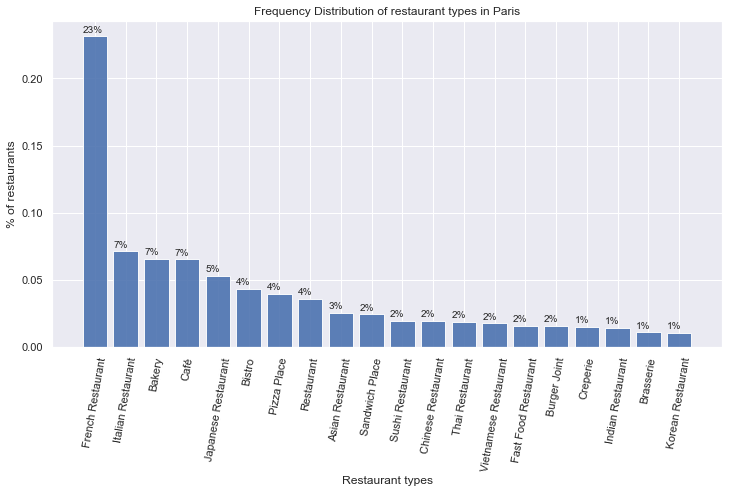

In [186]:
nb_types_to_show = 20

all_paris_venues = pd.read_pickle('paris_venues_unique.pkl').copy()

c = all_paris_venues['Venue Category'].value_counts(dropna=False)
p = all_paris_venues['Venue Category'].value_counts(dropna=False, normalize=True)
stats = pd.concat([c,p], axis=1, keys=['counts', '%']).head(nb_types_to_show)

print(c[0:nb_types_to_show])
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt


fig = plt.figure(figsize=(12, 6))
plt.bar(stats.index, stats['%'], alpha=0.9)
plt.title('Frequency Distribution of restaurant types in Paris')
plt.ylabel('% of restaurants', fontsize=12)
plt.xlabel('Restaurant types', fontsize=12)
plt.xticks(rotation=80)

ax = plt.gca()
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy() 
    ax.annotate('{:.0%}'.format(height), (x, y + height + 0.003))
plt.show()

### <font color='green'>French Restaurants are more than 3 times more frequent as any other type of restaurants</font>

## <font color='red'>1.7 Assign a <u>color to each type of restaurant</u></font>

In [17]:
import random

all_cat = all_paris_venues['Venue Category'].unique()
get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
#get_colors(5) # sample return:  ['#8af5da', '#fbc08c', '#b741d0', '#e599f1', '#bbcb59', '#a2a6c0']
list_of_colors = get_colors(len(all_cat))
cat_to_colors = pd.DataFrame([all_cat,list_of_colors]).transpose()
cat_to_colors.columns = ['cat','color']
merged_colors = pd.merge(all_paris_venues, cat_to_colors, left_on='Venue Category', right_on='cat')

merged_colors = merged_colors[['Venue','color']]

datas_merged = pd.merge(all_paris_venues, merged_colors, left_on='Venue', right_on='Venue')

restaurant_index = datas_merged.index[datas_merged['Venue Category'] == 'French Restaurant'].tolist()
other_index = list(set(datas_merged.index) - set(restaurant_index))
rows_french_restaurant = datas_merged.iloc[restaurant_index,:]
rows_other_restaurant = datas_merged.iloc[other_index,:] 
#print(len(rows_french_restaurant) , len(rows_other_restaurant))
#print(len(datas_merged.index))
#rows_other_restaurant.head()
result = pd.concat([rows_other_restaurant,rows_french_restaurant])
result.head()

,Venue,Venue Category,Latitude,Longitude,Location,color
1,Aux Délices du Palais,Bakery,48.826,2.3124,N-1,#4a2a56
2,Creperie Parisienne,Creperie,48.825,2.32008,N-1,#98f47d
3,La Pergola,Italian Restaurant,48.8231,2.3164,N-1,#a1ef85
4,Boulhanne,Thai Restaurant,48.8248,2.31733,N-1,#ed9aae
5,Monteleone,Italian Restaurant,48.8251,2.32023,N-1,#a1ef85


## <font color='red'>1.8 Restaurant types by color</font>

In [18]:
mapparis = folium.Map(location=[lat, lon], zoom_start=12)
for color,name,cat,i,j in zip(datas_merged['color'],datas_merged['Venue'], datas_merged['Venue Category'], datas_merged['Latitude'],datas_merged['Longitude']):
    displayed_name = name +" ("+cat+")"
    displayed_name = displayed_name.replace("'","\'")
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 1,
        popup= displayed_name,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        parse_html=False).add_to(mapparis)

mapparis

In [187]:
paris_venues = pd.read_pickle('paris_venues_unique.pkl')
paris = pd.read_pickle('paris_with_addresses_and_density.pkl')
paris.head()

,Address,Latitude,Longitude,Name,Postal code,Density
108,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109,75007,14228
142,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143,75016,21698
130,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131,75006,20499
131,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132,75004,17532
107,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108,75015,28314


## <font color='red'>2.1. let's find what are most frequent restaurants in each of our neighborhood</font>

In [188]:
paris_venues = pd.read_pickle('paris_venues_multiple.pkl')
# one hot encoding
paris_onehot = pd.get_dummies(paris_venues[['Venue Category']], prefix="", prefix_sep="")
# add location column back to dataframe
#paris_onehot['Venue'] = paris_venues['Venue'] 
paris_onehot['Location'] = paris_venues['Location'] 

# move location column to the first column
fixed_columns = [paris_onehot.columns[-1]] + list(paris_onehot.columns[:-1])
paris_onehot = paris_onehot[fixed_columns]



paris_grouped = paris_onehot.groupby('Location').mean().reset_index()

# Function to sort the venues in descending order
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

num_top_venues = 10
import numpy as np
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Location']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Location'] = paris_grouped['Location']

for ind in np.arange(paris_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(paris_grouped.iloc[ind, :], num_top_venues)
print(neighborhoods_venues_sorted.shape)
neighborhoods_venues_sorted.head()

(323, 11)


,Location,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,N-1,Italian Restaurant,Sushi Restaurant,Creperie,Pizza Place,Indian Restaurant,Café,Asian Restaurant,Thai Restaurant,Bakery,French Restaurant
1,N-10,Bakery,Italian Restaurant,Pizza Place,Fast Food Restaurant,Bistro,Salad Place,Sandwich Place,Moroccan Restaurant,Café,Sushi Restaurant
2,N-100,French Restaurant,Sandwich Place,Japanese Restaurant,Italian Restaurant,Bakery,Restaurant,Café,Pizza Place,Chinese Restaurant,Thai Restaurant
3,N-101,French Restaurant,Italian Restaurant,Japanese Restaurant,Bakery,Restaurant,Vietnamese Restaurant,Asian Restaurant,Sandwich Place,Bistro,Sushi Restaurant
4,N-102,French Restaurant,Bakery,Chinese Restaurant,Bistro,Vietnamese Restaurant,Japanese Restaurant,Falafel Restaurant,Café,Fast Food Restaurant,Sandwich Place


## <font color='red'>2.2. let's assign a color to each of our neighborhood based on most frequent restaurant type</font>

In [189]:
#paris_venues_single = pd.read_pickle('paris_venues_unique.pkl')
paris = pd.read_pickle('paris_with_addresses_and_density.pkl')
import random
#all_location = neighborhoods_venues_sorted['1st Most Common Venue'].unique()
all_location = neighborhoods_venues_sorted['1st Most Common Venue'].unique()
get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
#get_colors(5) # sample return:  ['#8af5da', '#fbc08c', '#b741d0', '#e599f1', '#bbcb59', '#a2a6c0']
list_of_colors = get_colors(len(all_location))
cat_to_colors = pd.DataFrame([all_location,list_of_colors]).transpose()
cat_to_colors.columns = ['cat','color']
merged_colors = pd.merge(neighborhoods_venues_sorted, cat_to_colors, left_on='1st Most Common Venue', right_on='cat')
print(merged_colors.shape)
merged_colors = merged_colors[['Location','1st Most Common Venue','color']]
#merged_colors.head()
#clean_paris_venues.head()

datas_merged = pd.merge(paris, merged_colors, left_on='Name', right_on='Location')
#datas_merged.drop(['Location','cat'],inplace=True,axis = 1)
print(datas_merged.shape)
datas_merged.head()

(323, 13)
(323, 9)


,Address,Latitude,Longitude,Name,Postal code,Density,Location,1st Most Common Venue,color
0,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109,75007,14228,N-109,French Restaurant,#3800bc
1,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143,75016,21698,N-143,French Restaurant,#3800bc
2,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131,75006,20499,N-131,French Restaurant,#3800bc
3,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132,75004,17532,N-132,French Restaurant,#3800bc
4,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108,75015,28314,N-108,French Restaurant,#3800bc


In [24]:
mapparis = folium.Map(location=[lat, lon], zoom_start=12)
for color,name,cat,i,j in zip(datas_merged['color'],datas_merged['Name'], datas_merged['1st Most Common Venue'], datas_merged['Latitude'],datas_merged['Longitude']):
    displayed_name = name +" ("+cat+")"
    displayed_name = displayed_name.replace("'"," ")
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 1,
        popup= displayed_name,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        parse_html=False).add_to(mapparis)

mapparis

### <font color='blue'><u>The case of French Restaurants</u></font>

### <font color='green'>French Restaurants are geographically almost equally distributed</font>

In [190]:
cat_df_flights = datas_merged.select_dtypes(include=['object']).copy()
#print(cat_df_flights.isnull().values.sum())
#print(cat_df_flights.isnull().sum())
carrier_count = cat_df_flights['1st Most Common Venue'].value_counts()
df_mesure_pt_counts = pd.DataFrame(carrier_count)
df_mesure_pt_counts.head(10)

,1st Most Common Venue
French Restaurant,254
Bakery,22
Café,11
Vietnamese Restaurant,7
Italian Restaurant,6
Japanese Restaurant,5
Indian Restaurant,3
Pizza Place,3
Restaurant,3
Chinese Restaurant,2


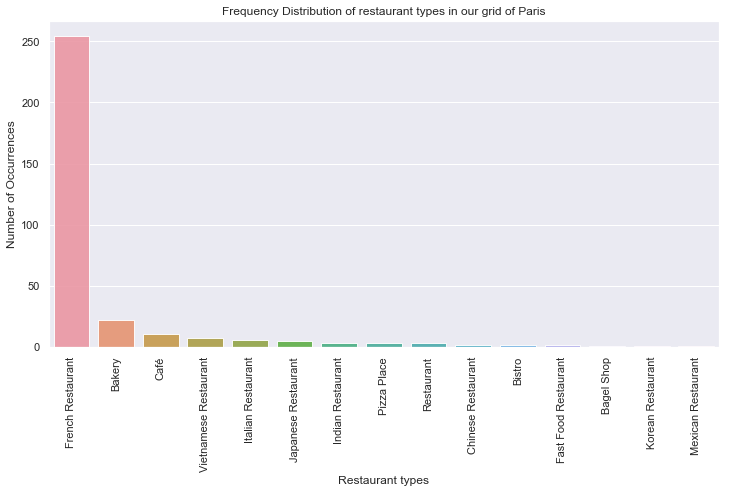

In [191]:
%matplotlib inline

import seaborn as sns
import matplotlib.pyplot as plt

sns.set(style="darkgrid")
fig = plt.figure(figsize=(12, 6))
sns.barplot(carrier_count.index, carrier_count.values, alpha=0.9)
plt.title('Frequency Distribution of restaurant types in our grid of Paris')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Restaurant types', fontsize=12)
plt.xticks(rotation=90)
plt.show()

### <font color='green'>If the client wants to open a French Restaurant, let's advice to open it somewhere French Restaurants are not in the 3 most common restaurant types</font>

In [192]:
points_where_advice_fr_rest = neighborhoods_venues_sorted[(neighborhoods_venues_sorted['1st Most Common Venue'] != 'French Restaurant') & (neighborhoods_venues_sorted['2nd Most Common Venue'] != 'French Restaurant') & (neighborhoods_venues_sorted['3rd Most Common Venue'] != 'French Restaurant')]

#print(points_where_advice_fr_rest['Location'])
data_merge_adresses = datas_merged[['Address','Latitude','Longitude','Name']]
data_merge_adresses.head()
adresses = data_merge_adresses['Name'].isin(points_where_advice_fr_rest['Location'])
print("Where to open a French Restaurant in Paris")

where_to_open_fr_rest = data_merge_adresses[adresses]
print("{} places to advice ".format(where_to_open_fr_rest.shape[0]))
where_to_open_fr_rest

Where to open a French Restaurant in Paris
27 places to advice 


,Address,Latitude,Longitude,Name
70,"Raymond Garcin, Rue d'Alésia, 75014 Paris, France",48.826940,2.338778,N-15
79,"14 Villa de Lourcine, 75014 Paris, France métr...",48.830752,2.338778,N-28
86,"39 Rue de Tanger, 75019 Paris, France",48.887932,2.369290,N-291
91,"2A Boulevard de Reims, 75017 Paris, France",48.891744,2.300637,N-295
94,"23 Rue des Maraîchers, 75020 Paris, France",48.850145,2.407379,N-322
100,"51 Rue Vauvenargues, 75018 Paris, France",48.895556,2.331150,N-310
104,"Résidence Torcy Evangile, Rue Marc Séguin, 750...",48.891744,2.361662,N-303
113,"34 Rue Philippe de Girard, 75010 Paris, France",48.884120,2.361662,N-276
125,"16 Rue du Borrégo, 75020 Paris, France",48.872684,2.399802,N-232
151,"20 bis Rue de la Justice, 75020 Paris, France",48.868872,2.407430,N-215


In [193]:
mapparis = folium.Map(location=[lat, lon], zoom_start=12)
for ad,name,i,j in zip(where_to_open_fr_rest['Address'],where_to_open_fr_rest['Name'], where_to_open_fr_rest['Latitude'],where_to_open_fr_rest['Longitude']):
    displayed_name = ad +" ("+name+")"
    displayed_name = displayed_name.replace("'","\'")
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 5,
        popup= displayed_name,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        parse_html=False).add_to(mapparis)
print("Points where French Restaurants are not in the 3 most frequent types of restaurants")
mapparis

Points where French Restaurants are not in the 3 most frequent types of restaurants


## <font color='red'>2.3. Let's remove "French restaurants" as they are too numerous, to learn more on other types, as well as "Restaurants" wich won't help us further</font>

In [29]:
paris_venues_without_french_rest = paris_venues[(paris_venues['Venue Category'] != 'French Restaurant') & (paris_venues['Venue Category'] != 'Restaurant')]
import folium

# one hot encoding
paris_onehot = pd.get_dummies(paris_venues_without_french_rest[['Venue Category']], prefix="", prefix_sep="")
# add location column back to dataframe
#paris_onehot['Venue'] = paris_venues['Venue'] 
paris_onehot['Location'] = paris_venues_without_french_rest['Location'] 

# move location column to the first column
fixed_columns = [paris_onehot.columns[-1]] + list(paris_onehot.columns[:-1])
paris_onehot = paris_onehot[fixed_columns]



paris_grouped = paris_onehot.groupby('Location').mean().reset_index()

# Function to sort the venues in descending order
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

num_top_venues = 5
import numpy as np
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Location']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Location'] = paris_grouped['Location']

for ind in np.arange(paris_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(paris_grouped.iloc[ind, :], num_top_venues)
#print(neighborhoods_venues_sorted.shape)
#neighborhoods_venues_sorted.head()


import random
all_location = neighborhoods_venues_sorted['1st Most Common Venue'].unique()
get_colors = lambda n: list(map(lambda i: "#" + "%06x" % random.randint(0, 0xFFFFFF),range(n)))
#get_colors(5) # sample return:  ['#8af5da', '#fbc08c', '#b741d0', '#e599f1', '#bbcb59', '#a2a6c0']
list_of_colors = get_colors(len(all_location))
cat_to_colors = pd.DataFrame([all_location,list_of_colors]).transpose()
cat_to_colors.columns = ['cat','color']
merged_colors = pd.merge(neighborhoods_venues_sorted, cat_to_colors, left_on='1st Most Common Venue', right_on='cat')
#merged_colors.head()
#clean_paris_venues.head()
datas_merged = pd.merge(paris_venues_without_french_rest, merged_colors, left_on='Location', right_on='Location')
datas_merged.drop(['Location','cat'],inplace=True,axis = 1)
datas_merged.head()


mapparis_without_french_rest = folium.Map(location=[lat, lon], zoom_start=12)
for color,name,cat,i,j in zip(datas_merged['color'],datas_merged['Venue'], datas_merged['1st Most Common Venue'], datas_merged['Latitude'],datas_merged['Longitude']):
    displayed_name = name +" ("+cat+")"
    displayed_name = displayed_name.replace("'"," ")
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 1,
        popup= displayed_name,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        parse_html=False).add_to(mapparis_without_french_rest)

mapparis_without_french_rest

## <font color='red'>2.4. How are restaurants other than French restaurants distributed ?</font>

French Restaurant        254
Bakery                    22
Café                      11
Vietnamese Restaurant      7
Italian Restaurant         6
Japanese Restaurant        5
Indian Restaurant          3
Pizza Place                3
Restaurant                 3
Chinese Restaurant         2
Name: 1st Most Common Venue, dtype: int64


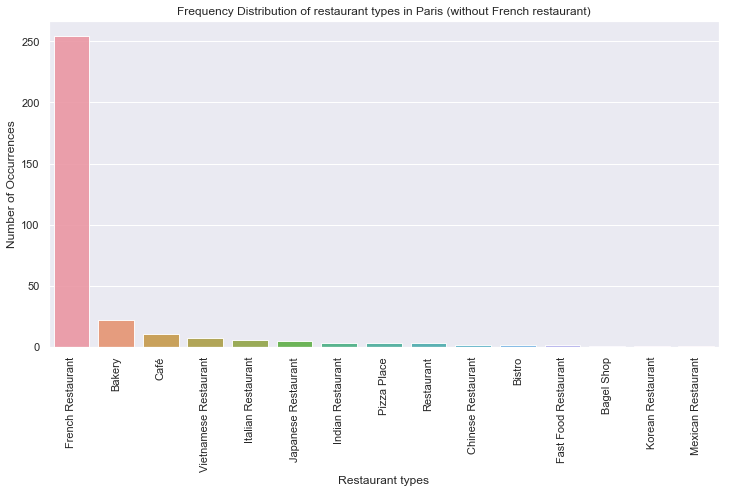

In [194]:
cat_df_flights = datas_merged.select_dtypes(include=['object']).copy()
#print(cat_df_flights.isnull().values.sum())
#print(cat_df_flights.isnull().sum())
print(cat_df_flights['1st Most Common Venue'].value_counts().head(10))
#cat_df_flights.head()
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt
carrier_count = cat_df_flights['1st Most Common Venue'].value_counts()
sns.set(style="darkgrid")
fig = plt.figure(figsize=(12, 6))
sns.barplot(carrier_count.index, carrier_count.values, alpha=0.9)
plt.title('Frequency Distribution of restaurant types in Paris (without French restaurant)')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Restaurant types', fontsize=12)
plt.xticks(rotation=90)
plt.show()

## <font color='red'>2.5. Let's select the first 10 venue types most frequent amoung them</font>

In [195]:
top_10_types = cat_df_flights['1st Most Common Venue'].value_counts().head(10).index.values.tolist()
top_10_types

['French Restaurant',
 'Bakery',
 'Café',
 'Vietnamese Restaurant',
 'Italian Restaurant',
 'Japanese Restaurant',
 'Indian Restaurant',
 'Pizza Place',
 'Restaurant',
 'Chinese Restaurant']

In [196]:
paris_venues_without_french_rest.head()
filtered_venu_list = paris_venues_without_french_rest[paris_venues_without_french_rest['Venue Category'].isin(top_10_types)]
print(filtered_venu_list.shape)
#filtered_venu_list.to_pickle('paris_venues_without_french_rest.pkl')
filtered_venu_list.head()

(5532, 5)


,Location,Latitude,Longitude,Venue,Venue Category
1,N-1,48.826002,2.312395,Aux Délices du Palais,Bakery
3,N-1,48.823137,2.316404,La Pergola,Italian Restaurant
5,N-1,48.825127,2.320232,Monteleone,Italian Restaurant
7,N-1,48.825043,2.318383,Café Brune,Café
8,N-1,48.825888,2.313756,L'Auberge Calabraise,Italian Restaurant


## <font color='red'>2.6. Let's find and consider the distribution of restaurant types for each neighborhood</font>

In [197]:
#filtered_venu_list.groupby('Location').count().sort_values(by='Venue',ascending=False)
# one hot encoding
paris_filtered_venues_onehot = pd.get_dummies(filtered_venu_list[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
paris_filtered_venues_onehot['Neighborhood'] = filtered_venu_list['Location'] 

# move neighborhood column to the first column
fixed_columns = [paris_filtered_venues_onehot.columns[-1]] + list(paris_filtered_venues_onehot.columns[:-1])
paris_filtered_venues_onehot = paris_filtered_venues_onehot[fixed_columns]

paris_filtered_venues_onehot.head()

paris_filtered_venues_grouped = paris_filtered_venues_onehot.groupby('Neighborhood').mean().reset_index()

num_top_venues = 10

result_type_frequency = {}
i = 0
for hood in paris_filtered_venues_grouped['Neighborhood']:
    i = i+1
    if(i < 3):
        print("----"+hood+"----")
    temp = paris_filtered_venues_grouped[paris_filtered_venues_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    out = temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues)
    if(i < 3):
        print(out)
        print('')
    result_type_frequency[hood] = out
    #print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    #print('\n')
#result_type_frequency

----N-1----
                   venue  freq
0     Italian Restaurant  0.43
1                 Bakery  0.14
2                   Café  0.14
3      Indian Restaurant  0.14
4            Pizza Place  0.14
5     Chinese Restaurant  0.00
6    Japanese Restaurant  0.00
7  Vietnamese Restaurant  0.00

----N-10----
                   venue  freq
0                 Bakery   0.3
1     Italian Restaurant   0.3
2            Pizza Place   0.2
3                   Café   0.1
4    Japanese Restaurant   0.1
5     Chinese Restaurant   0.0
6      Indian Restaurant   0.0
7  Vietnamese Restaurant   0.0



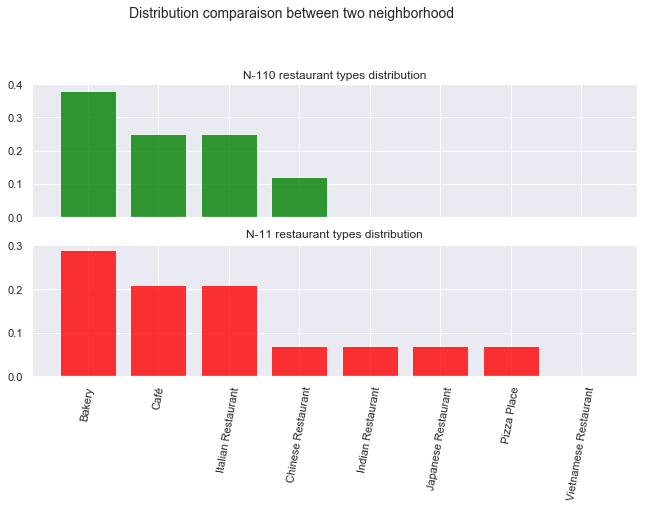

7

In [199]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

plt.rcParams["figure.figsize"] = (12,6)
f, (ax1, ax2) = plt.subplots(2, 1,sharex=True)
ax1.bar(x=result_type_frequency['N-110']['venue'],height=result_type_frequency['N-110']['freq'],color='green',alpha=0.8)
ax1.set_title('N-110 restaurant types distribution')
ax2.bar(x=result_type_frequency['N-11']['venue'],height=result_type_frequency['N-11']['freq'],color='red',alpha=0.8)
ax2.set_title('N-11 restaurant types distribution')
plt.xticks(rotation=80)


plt.suptitle('Distribution comparaison between two neighborhood', fontsize=14)
plt.subplots_adjust(left=0.2, wspace=0.8, top=0.8)
plt.show()

sum(result_type_frequency['N-11']['freq'] != 0.00)

## <font color='red'>2.7. This leads us to distinguish diversified neighborhoods from non-diversified neighborhoods</font>
## <font color='blue'>Let's give 1 point to neighborhoods whose diversity is above mean and 0 to others</font>

In [200]:
diversity_dict = {}
for hood,neighborhood_freq in result_type_frequency.items():
    x = sum(neighborhood_freq['freq'] != 0.00)
    diversity_dict[hood] = x
    #print("len of {} is {} ".format(hood,x))
#print("diversity_dict is ".format(len(diversity_dict)))
moyenne = sum(list(diversity_dict.values()))/len(list(diversity_dict.values())) 

mesure_of_diversity_dict = {}
for hood,diversity_mesure in diversity_dict.items():
    if(diversity_mesure >= moyenne):
        mesure_of_diversity_dict[hood] = 1
    else:
        mesure_of_diversity_dict[hood] = 0


diversity = pd.DataFrame.from_dict(mesure_of_diversity_dict, orient='index',columns=['diversity_score'])
diversity['Neighborhood'] = diversity.index
diversity.reset_index(inplace = True)
diversity['diversity_score'].astype(float, inplace=True)
#print(diversity.isnull().any())
#print(len(diversity))
#print(diversity.dtypes)
diversity.head()

,index,diversity_score,Neighborhood
0,N-1,0,N-1
1,N-10,0,N-10
2,N-100,1,N-100
3,N-101,1,N-101
4,N-102,1,N-102


## <font color='red'>2.8. let's add the diversity score to our neighborhoods</font>

In [201]:
#paris_venues = pd.read_pickle('paris_venues_with_density_and_postcode.pkl')
paris = pd.read_pickle('paris_with_addresses_and_density.pkl')
#paris = pd.read_pickle('paris.pkl')
#print("paris")
#print(paris.head())
#print(paris.isnull().any())
#print(len(paris['Name']))
#print('***************')

#print("diversity")
#print(diversity.head())
#rint(diversity.isnull().any())
#print(len(diversity['Neighborhood']))
#paris = .to_pickle('paris_venues_without_french_rest.pkl')
df_join = paris.join(diversity.set_index('Neighborhood'), on='Name')
df_join = df_join.fillna(0)

#df_join.isnull().index
#nuls = df_join.isnull()

#for nul in nuls:
#    df_join.iloc[nul,'diversity_score'] = 0
#df_join[nuls,'diversity_score'] = 0
#for hood,diversity_score in zip(df_join['Neighborhood'],df_join['diversity_score']):
#    if(diversity_score*diversity_score != diversity_score):
#        print(hood)
#print(df_join.isnull().any())
df_join.drop('index', axis = 1, inplace = True)
#df_join.to_pickle('paris_with_addresses_density_diversity.pkl')
#print(len(df_join))
df_join.head()

,Address,Latitude,Longitude,Name,Postal code,Density,diversity_score
108,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109,75007,14228,0
142,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143,75016,21698,0
130,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131,75006,20499,1
131,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132,75004,17532,0
107,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108,75015,28314,1


In [202]:
#df_join.to_pickle('paris_with_addresses_density_diversity.pkl')

## <font color='blue'>Let's introduce distance to 20 famous monuments in Paris</font>

In [205]:
monuments = pd.read_pickle('monuments.pkl')
monuments.head()

,Name,Address,postalCode,latitude,longitude
0,Cathédrale Notre-Dame de Paris,6 place du parvis Notre-Dame,75004,48.853124,2.349561
1,Tour Eiffel,5 avenue Anatole France,75007,48.858249,2.294426
2,Sainte-Chapelle,8 boulevard du Palais,75001,48.855395,2.344975
3,Arc de Triomphe (Arc de Triomphe de l'Étoile),Place Charles de Gaulle,75008,48.873783,2.295059
4,Moulin Rouge,82 boulevard de Clichy,75018,48.884169,2.332363


## <font color='red'>2.9. associate each neighborhood to its shortest distance to any of those monuments</font>

In [204]:
#paris_venues = pd.read_pickle('paris_venues_with_density_and_postcode.pkl')
paris_venues_without_french_rest.head()

,Location,Latitude,Longitude,Venue,Venue Category
1,N-1,48.826002,2.312395,Aux Délices du Palais,Bakery
2,N-1,48.824972,2.320082,Creperie Parisienne,Creperie
3,N-1,48.823137,2.316404,La Pergola,Italian Restaurant
4,N-1,48.824818,2.317333,Boulhanne,Thai Restaurant
5,N-1,48.825127,2.320232,Monteleone,Italian Restaurant


In [206]:
#df_join.to_pickle('paris_with_diversity_score.pkl')

import math
def haversine(coord1, coord2):
    R = 6372800  # Earth radius in meters
    lat1, lon1 = coord1
    lat2, lon2 = coord2
    phi1, phi2 = math.radians(lat1), math.radians(lat2) 
    dphi       = math.radians(lat2 - lat1)
    dlambda    = math.radians(lon2 - lon1)
    a = math.sin(dphi/2)**2 + \
        math.cos(phi1)*math.cos(phi2)*math.sin(dlambda/2)**2
    return float(round(2*R*math.atan2(math.sqrt(a), math.sqrt(1 - a))))

shortest_distance = {}


for name,latitude,longitude in zip(paris_venues_without_french_rest['Location'],paris_venues_without_french_rest['Latitude'],paris_venues_without_french_rest['Longitude']):
    #print(name)
    stored_shortest_distance = 20000
    for lat_monuments,lon_monuments in zip(monuments['latitude'],monuments['longitude']):
        distance = haversine((latitude,longitude), (lat_monuments,lon_monuments))
        if(distance < stored_shortest_distance):
            stored_shortest_distance = distance
    shortest_distance[name] = stored_shortest_distance

shortest_distance_df = pd.DataFrame.from_dict(shortest_distance, orient='index',columns=['proximity_score'])
shortest_distance_df['Neighborhood'] = shortest_distance_df.index
shortest_distance_df.reset_index(inplace = True)
shortest_distance_df.drop('index',axis=1,inplace = True)
shortest_distance_df = shortest_distance_df[['Neighborhood','proximity_score']]

#shortest_distance_df
shortest_distance_df.head()

,Neighborhood,proximity_score
0,N-1,1483.0
1,N-2,1508.0
2,N-3,1325.0
3,N-4,1774.0
4,N-5,1774.0


## <font color='red'>2.10. get the mean of those distances</font>

In [207]:
moyenne_prox = shortest_distance_df['proximity_score'].mean()
moyenne_prox = round(moyenne_prox)
print("The mean distance to a monument in Paris is around {} meters".format(moyenne_prox))

The mean distance to a monument in Paris is around 1589 meters


## <font color='red'>2.11. and give 2,1 or 0 point(s) to neighborhoods wich is very close, close or far from any monument</font>

In [208]:
mesure_of_proximity_dict = {}
for hood,proximity_mesure in zip(shortest_distance_df['Neighborhood'],shortest_distance_df['proximity_score']):
    if(proximity_mesure <= moyenne_prox/3):
        mesure_of_proximity_dict[hood] = 2
    elif((proximity_mesure > moyenne_prox/3) & (proximity_mesure <= 2*moyenne_prox/3)):
        mesure_of_proximity_dict[hood] = 1
    else:
        mesure_of_proximity_dict[hood] = 0

proximity = pd.DataFrame.from_dict(mesure_of_proximity_dict, orient='index',columns=['proximity_score'])
proximity['Neighborhood'] = proximity.index
proximity.reset_index(inplace = True)
proximity.drop('index',axis=1,inplace = True)
proximity = proximity[['Neighborhood','proximity_score']]
proximity.head()

,Neighborhood,proximity_score
0,N-1,0
1,N-2,0
2,N-3,0
3,N-4,0
4,N-5,0


## <font color='red'>2.12. join the results to geo coordinates</font>

In [209]:
paris_with_diversity_score = pd.read_pickle('paris_with_addresses_density_diversity.pkl')
#print(paris_with_diversity_score.isnull().any())
#print(proximity.head())
#print(paris_with_diversity_score.shape())
#print(proximity.isnull().any())
df_join = paris_with_diversity_score.join(proximity.set_index('Neighborhood'), on='Name')
df_join = df_join.fillna(0)
print(df_join.isnull().any())
#print(df_join.shape())

df_join.head()

Address            False
Latitude           False
Longitude          False
Name               False
Postal code        False
Density            False
diversity_score    False
proximity_score    False
dtype: bool


,Address,Latitude,Longitude,Name,Postal code,Density,diversity_score,proximity_score
108,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109,75007,14228,0,1
142,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143,75016,21698,0,1
130,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131,75006,20499,1,1
131,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132,75004,17532,0,2
107,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108,75015,28314,1,1


In [213]:
n = df_join[(df_join['diversity_score'] ==1) & (df_join['proximity_score'] ==2)].shape[0]
print("We can advice {} neighborhoods above out of {} based on diversity and proximity to monuments".format(n,df_join.shape[0]))

We can advice 34 neighborhoods above out of 323 based on diversity and proximity to monuments


## <font color='red'>2.13. Let's turn population density into a 0,1 or 2 points score</font>

In [214]:
df_join["Density"] = df_join["Density"].astype('float64', copy=True)
bins = np.linspace(min(df_join["Density"]), max(df_join["Density"]), 4)
group_names = ['0', '1', '2']
df_join['density_score'] = pd.cut(df_join["Density"], bins, labels=group_names, include_lowest=True )
#df_join["density_score"] = df_join["density_score"].astype('int', copy=True)
df_join.head(20)

,Address,Latitude,Longitude,Name,Postal code,Density,diversity_score,proximity_score,density_score
108,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109,75007,14228.0,0,1,0
142,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143,75016,21698.0,0,1,1
130,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131,75006,20499.0,1,1,0
131,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132,75004,17532.0,0,2,0
107,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108,75015,28314.0,1,1,1
217,"3 Avenue Victor Hugo, 75116 Paris, France métr...",48.872684,2.293009,N-218,75016,21698.0,0,2,1
167,"4 Avenue du Général Lemonnier, 75001 Paris, Fr...",48.861248,2.331150,N-168,75001,9457.0,0,2,0
164,"6 Avenue Sully-Prud'homme, 75007 Paris, France",48.861248,2.308265,N-165,75007,14228.0,0,2,0
163,"192 Rue de l'Université, 75007 Paris, France",48.861248,2.300637,N-164,75007,14228.0,1,2,0
162,"Port Debilly, 75016 Paris, France métropolitaine",48.861248,2.293009,N-163,75016,21698.0,0,2,1


In [215]:
#df_join['Density'] = df_join['Density'].fillna(df_join['Density'].astype('float64').mean())
#df_join['density_score'] = df_join['density_score'].fillna('0')
#df_join['density_score'] = df_join['density_score'].astype(int)
#print(df_join.isnull().any())
#df_join.to_pickle('paris_with_scores.pkl')

Address            False
Latitude           False
Longitude          False
Name               False
Postal code        False
Density            False
diversity_score    False
proximity_score    False
density_score      False
dtype: bool


In [216]:
paris = pd.read_pickle('paris_with_scores.pkl')
#type(paris)
paris.head()

,Address,Latitude,Longitude,Name,Postal code,Density,diversity_score,proximity_score,density_score
108,"53 Avenue de Ségur, 75007 Paris, France",48.849812,2.308265,N-109,75007,14228.0,0,1,0
142,"3b Rue de l'Alboni, 75016 Paris, France métrop...",48.857436,2.285381,N-143,75016,21698.0,0,1,1
130,"68 Rue Saint-André des Arts, 75006 Paris, France",48.853624,2.338778,N-131,75006,20499.0,1,1,0
131,"2 Quai du Marché Neuf, 75004 Paris, France",48.853624,2.346406,N-132,75004,17532.0,0,2,0
107,"7 Rue de la Cavalerie, 75015 Paris, France",48.849812,2.300637,N-108,75015,28314.0,1,1,1


In [217]:
paris[['diversity_score', 'proximity_score', 'density_score']] = paris[['diversity_score', 'proximity_score', 'density_score']].astype('int')

In [225]:
paris['total_score'] = paris['diversity_score'] + paris['proximity_score'] + paris['density_score']
num_score_max1 = paris[paris['total_score'] >= 5.0].shape[0]
num_score_max2 = paris[paris['total_score'] == 4.0].shape[0]

recommand1 = paris[paris['total_score'] >= 5.0] #.head(num_score_max)
recommand2 = paris[paris['total_score'] == 4.0]
print("We can now advice {} neighborhoods in Paris out of {} based on diversity , proximity to monuments and population density".format(num_score_max1+num_score_max2,df_join.shape[0]))

recommand = pd.concat([recommand1,recommand2])
recommand

We can now advice 22 neighborhoods in Paris out of 323 based on diversity , proximity to monuments and population density


,Address,Latitude,Longitude,Name,Postal code,Density,diversity_score,proximity_score,density_score,total_score
286,"Rue de l'Abreuvoir, 75018 Paris, France",48.887932,2.338778,N-287,75018,33769.0,1,2,2,5
288,"30 Rue de Laghouat, 75018 Paris, France",48.887932,2.354034,N-289,75018,33769.0,1,2,2,5
272,"10 Rue des Abbesses, 75018 Paris, France",48.884120,2.338778,N-273,75018,33769.0,1,2,2,5
273,"4 Rue d'Orsel, 75018 Paris, France",48.884120,2.346406,N-274,75018,33769.0,1,2,2,5
287,"6 Passage Cottin, 75018 Paris, France métropol...",48.887932,2.346406,N-288,75018,33769.0,1,2,2,5
250,"16 Rue Pierre Demours, 75017 Paris, France",48.880308,2.293009,N-251,75017,30331.0,1,2,1,4
198,"85 Avenue Raymond Poincaré, 75116 Paris, France",48.868872,2.285381,N-199,75016,21698.0,1,2,1,4
105,"16A Rue du Théâtre, 75015 Paris, France",48.849812,2.285381,N-106,75015,28314.0,1,2,1,4
199,"3b Rue Dumont d'Urville, 75116 Paris, France",48.868872,2.293009,N-200,75016,21698.0,1,2,1,4
95,"Panthéon, Place du Panthéon, 75005 Paris, France",48.846000,2.346406,N-96,75005,24038.0,1,2,1,4


In [226]:
#paris.to_pickle('paris_scores.pkl')

### <font color='green'>Location of neighborhoods we can advice, based on diversity, proximity to monuments and population: density</font>

In [229]:
mapparis = folium.Map(location=[lat, lon], zoom_start=12)
for name,ad,i,j in zip(recommand1['Name'],recommand1['Address'],recommand1['Latitude'],recommand1['Longitude']):
    displayed_name = "Grade 5 "+ad.replace("'","\'")+" "+name
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 5,
        popup= displayed_name,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=1,
        parse_html=False).add_to(mapparis)
    
for name,ad,i,j in zip(recommand2['Name'],recommand2['Address'],recommand2['Latitude'],recommand2['Longitude']):
    displayed_name = "Grade 4 "+ad.replace("'","\'")+" "+name
    folium.CircleMarker(
        [float(i), float(j)],
        radius= 5,
        popup= displayed_name,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=1,
        parse_html=False).add_to(mapparis)
mapparis

## <font color='red'>3.1. Neighborhoods Clustering</font>

In [49]:
paris_venues = pd.read_pickle('paris_venues_multiple.pkl')
# one hot encoding
paris_onehot = pd.get_dummies(paris_venues[['Venue Category']], prefix="", prefix_sep="")
# add location column back to dataframe
#paris_onehot['Venue'] = paris_venues['Venue'] 
paris_onehot['Location'] = paris_venues['Location'] 
# move location column to the first column
fixed_columns = [paris_onehot.columns[-1]] + list(paris_onehot.columns[:-1])
paris_onehot = paris_onehot[fixed_columns]

paris_grouped = paris_onehot.groupby('Location').mean().reset_index()

print(paris_grouped.shape)
paris_grouped.head()

(323, 130)


,Location,Afghan Restaurant,African Restaurant,Alsatian Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,Auvergne Restaurant,BBQ Joint,...,Thai Restaurant,Theme Restaurant,Tibetan Restaurant,Trattoria/Osteria,Turkish Restaurant,Udon Restaurant,Vegetarian / Vegan Restaurant,Venezuelan Restaurant,Vietnamese Restaurant,Wings Joint
0,N-1,0.0,0.0,0.0,0.000000,0.0,0.0,0.071429,0.0,0.0,...,0.071429,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.000000,0.0
1,N-10,0.0,0.0,0.0,0.000000,0.0,0.0,0.045455,0.0,0.0,...,0.000000,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.000000,0.0
2,N-100,0.0,0.0,0.0,0.000000,0.0,0.0,0.020000,0.0,0.0,...,0.020000,0.0,0.0,0.0,0.02,0.0,0.01,0.0,0.020000,0.0
3,N-101,0.0,0.0,0.0,0.000000,0.0,0.0,0.057143,0.0,0.0,...,0.028571,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.057143,0.0
4,N-102,0.0,0.0,0.0,0.027778,0.0,0.0,0.027778,0.0,0.0,...,0.027778,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.055556,0.0


In [53]:
#paris_grouped.to_pickle('paris_grouped.pkl')

In [ ]:
#paris_grouped = pd.read_pickle('paris_grouped.pkl')
#print(paris_grouped.shape)
#paris_grouped.head()

In [57]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

num_top_venues = 10
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = paris_grouped['Location']

for ind in np.arange(paris_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(paris_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,N-1,Italian Restaurant,Sushi Restaurant,Creperie,Pizza Place,Indian Restaurant,Café,Asian Restaurant,Thai Restaurant,Bakery,French Restaurant
1,N-10,Bakery,Italian Restaurant,Pizza Place,Fast Food Restaurant,Bistro,Salad Place,Sandwich Place,Moroccan Restaurant,Café,Sushi Restaurant
2,N-100,French Restaurant,Sandwich Place,Japanese Restaurant,Italian Restaurant,Bakery,Restaurant,Café,Pizza Place,Chinese Restaurant,Thai Restaurant
3,N-101,French Restaurant,Italian Restaurant,Japanese Restaurant,Bakery,Restaurant,Vietnamese Restaurant,Asian Restaurant,Sandwich Place,Bistro,Sushi Restaurant
4,N-102,French Restaurant,Bakery,Chinese Restaurant,Bistro,Vietnamese Restaurant,Japanese Restaurant,Falafel Restaurant,Café,Fast Food Restaurant,Sandwich Place


In [ ]:
'''
num_top_venues = 5
i = 0
for hood in paris_grouped['Location']:
    i = i+1
    if(i<5):
        print("----"+hood+"----")
        temp = paris_grouped[paris_grouped['Location'] == hood].T.reset_index()
        temp.columns = ['venue','freq']
        temp = temp.iloc[1:]
        temp['freq'] = temp['freq'].astype(float)
        temp = temp.round({'freq': 2})
        print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
        print('\n')
'''

In [51]:
'''
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]
'''

In [ ]:
'''
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = paris_grouped['Location']

for ind in np.arange(paris_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(paris_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()
'''

In [ ]:
'''
from sklearn.cluster import KMeans
kclusters = 5
paris_grouped_clustering = paris_grouped.drop('Location', 1)
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(paris_grouped_clustering)
# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 
'''

## <font color='red'>3.2. Run Elbow Method to determine optimal number of clusters</font>

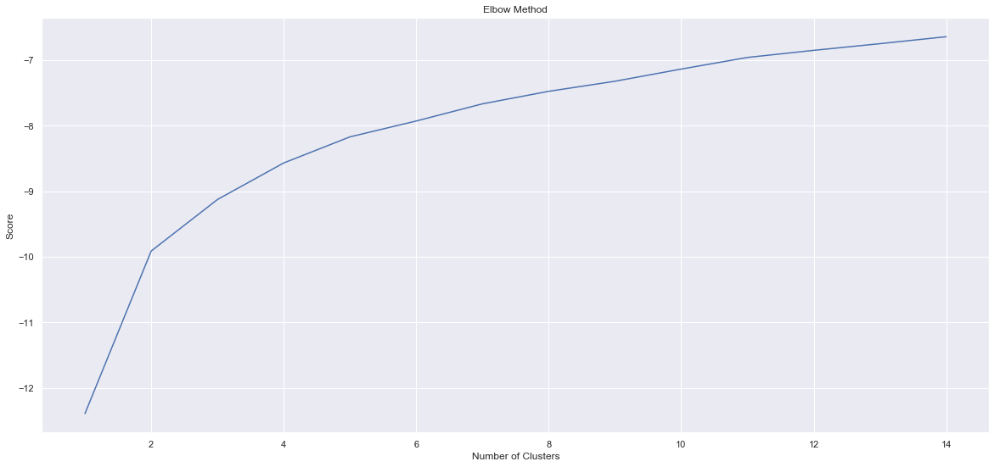

In [56]:
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
%matplotlib inline  

paris_grouped_clustering = paris_grouped.drop('Location', 1)

number_clusters = range(1, 15)

kmeans = [KMeans(n_clusters=i, max_iter = 600) for i in number_clusters]
kmeans

score = [kmeans[i].fit(paris_grouped_clustering).score(paris_grouped_clustering) for i in range(len(kmeans))]
score

plt.rcParams["figure.figsize"] = (20,9)
plt.plot(number_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Method')
plt.show()

In [153]:
#from sklearn.cluster import KMeans
#kclusters = 2
#paris_grouped_clustering = paris_grouped.drop('Location', 1)
# run k-means clustering
#kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(paris_grouped_clustering)
# check cluster labels generated for each row in the dataframe
#kmeans.labels_[0:10] 
#paris = pd.read_pickle('paris_with_scores.pkl')
#paris.head()

## <font color='green'>It seems that elbows are located at 2 and 5 clusters</font>

### <font color='green'>so let's see what repartitions we have from 2 to 5 clusters</font>

## <font color='red'>3.2.1 Repartition in 2 clusters</font>

In [59]:
from sklearn.cluster import KMeans
kclusters = 2
paris_grouped_clustering = paris_grouped.drop('Location', 1)
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(paris_grouped_clustering)
paris = pd.read_pickle('paris_with_scores.pkl')
# add clustering labels
if 'Cluster Labels' in neighborhoods_venues_sorted.columns:
    # add clustering labels
    neighborhoods_venues_sorted.drop('Cluster Labels',axis=1, inplace=True)
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

paris_merged = paris.copy()

# merge paris_grouped with toronto_data to add latitude/longitude for each neighborhood
paris_merged = paris_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Name')


# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)
import matplotlib.cm as cm
import matplotlib.colors as colors
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(paris_merged['Latitude'], paris_merged['Longitude'], paris_merged['Name'], paris_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

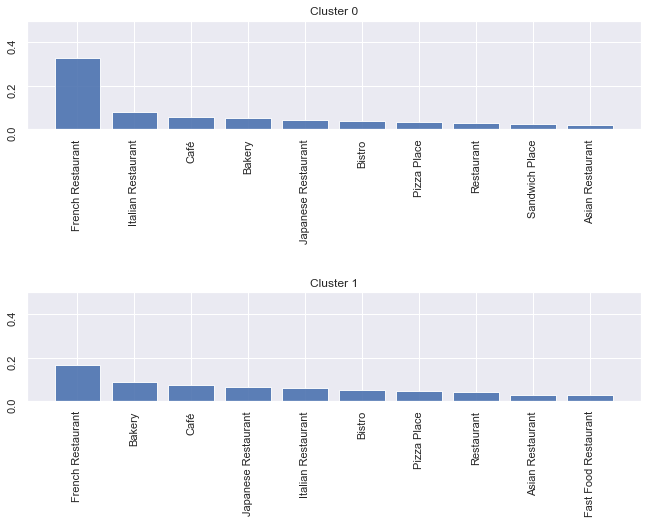

In [152]:
clusters_to_names = paris_merged[['Cluster Labels','Name']]
#paris_grouped.head()
#print(clusters_to_names.shape)
#print(clusters_to_names.head())
#paris_grouped.head()
stats = paris_grouped.join(clusters_to_names.set_index('Name'), on='Location')
stats_store = {}
x = stats.groupby('Cluster Labels').mean().T
#.sort_values('lifeExp')
for col_name in x.columns.values.tolist():
    name_cluster = "Cluster "+str(col_name)
    y = x[col_name].copy()
    ten_most = y.sort_values(ascending=False)[0:10]
    stats_store.update({name_cluster:ten_most})

    
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt


num_plots = len(stats_store.keys())

fig, ax = plt.subplots(num_plots, sharey='row') 
fig.subplots_adjust(hspace=1.5)
fig.set_size_inches(w=11,h=7)

for i in range(num_plots):
    name_cluster = "Cluster "+str(i)
    ploted = stats_store[name_cluster]
    ax[i].bar(ploted.index, ploted.values, alpha=0.9)
    ax[i].tick_params(rotation=90)
    ax[i].set_ylim([0, 0.5])
    ax[i].title.set_text(name_cluster)



## <font color='red'>3.2.2 Repartition in 3 clusters</font>

In [154]:
from sklearn.cluster import KMeans
kclusters = 3
paris_grouped_clustering = paris_grouped.drop('Location', 1)
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(paris_grouped_clustering)
paris = pd.read_pickle('paris_with_scores.pkl')
# add clustering labels
if 'Cluster Labels' in neighborhoods_venues_sorted.columns:
    # add clustering labels
    neighborhoods_venues_sorted.drop('Cluster Labels',axis=1, inplace=True)
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

paris_merged = paris.copy()

# merge paris_grouped with toronto_data to add latitude/longitude for each neighborhood
paris_merged = paris_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Name')


# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)
import matplotlib.cm as cm
import matplotlib.colors as colors
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(paris_merged['Latitude'], paris_merged['Longitude'], paris_merged['Name'], paris_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

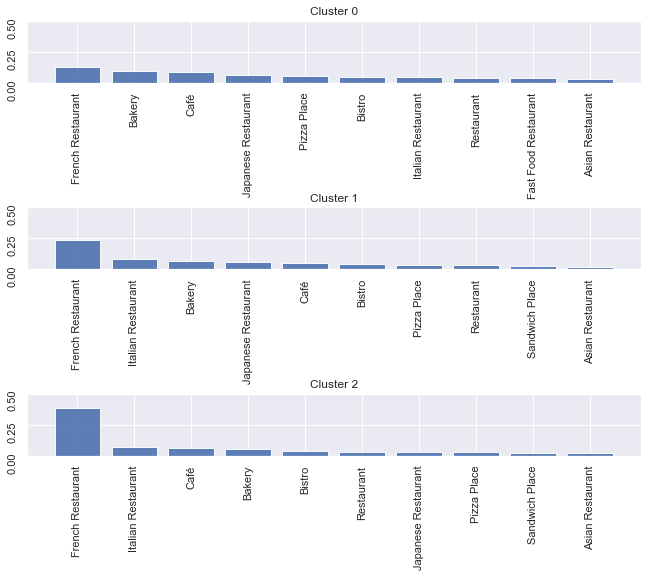

In [157]:
clusters_to_names = paris_merged[['Cluster Labels','Name']]
#paris_grouped.head()
#print(clusters_to_names.shape)
#print(clusters_to_names.head())
#paris_grouped.head()
stats = paris_grouped.join(clusters_to_names.set_index('Name'), on='Location')
stats_store = {}
x = stats.groupby('Cluster Labels').mean().T
#.sort_values('lifeExp')
for col_name in x.columns.values.tolist():
    name_cluster = "Cluster "+str(col_name)
    y = x[col_name].copy()
    ten_most = y.sort_values(ascending=False)[0:10]
    stats_store.update({name_cluster:ten_most})

    
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt


num_plots = len(stats_store.keys())

fig, ax = plt.subplots(num_plots, sharey='row') 
fig.subplots_adjust(hspace=2)
fig.set_size_inches(w=11,h=8)

for i in range(num_plots):
    name_cluster = "Cluster "+str(i)
    ploted = stats_store[name_cluster]
    ax[i].bar(ploted.index, ploted.values, alpha=0.9)
    ax[i].tick_params(rotation=90)
    ax[i].set_ylim([0, 0.5])
    ax[i].title.set_text(name_cluster)

## <font color='red'>3.2.3 Repartition in 4 clusters</font>

In [158]:
from sklearn.cluster import KMeans
kclusters = 4
paris_grouped_clustering = paris_grouped.drop('Location', 1)
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(paris_grouped_clustering)
paris = pd.read_pickle('paris_with_scores.pkl')
# add clustering labels
if 'Cluster Labels' in neighborhoods_venues_sorted.columns:
    # add clustering labels
    neighborhoods_venues_sorted.drop('Cluster Labels',axis=1, inplace=True)
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

paris_merged = paris.copy()

# merge paris_grouped with toronto_data to add latitude/longitude for each neighborhood
paris_merged = paris_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Name')


# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)
import matplotlib.cm as cm
import matplotlib.colors as colors
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(paris_merged['Latitude'], paris_merged['Longitude'], paris_merged['Name'], paris_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

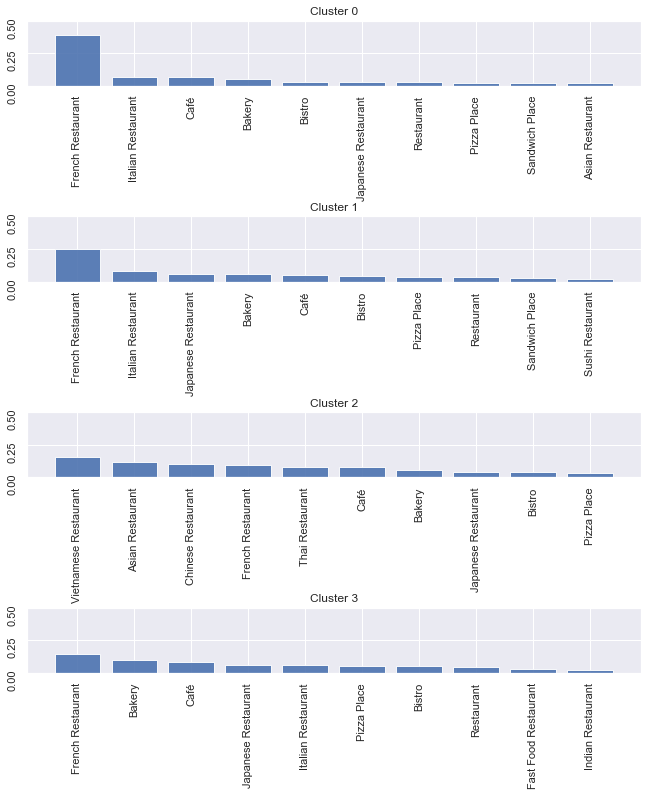

In [161]:
clusters_to_names = paris_merged[['Cluster Labels','Name']]
#paris_grouped.head()
#print(clusters_to_names.shape)
#print(clusters_to_names.head())
#paris_grouped.head()
stats = paris_grouped.join(clusters_to_names.set_index('Name'), on='Location')
stats_store = {}
x = stats.groupby('Cluster Labels').mean().T
#.sort_values('lifeExp')
for col_name in x.columns.values.tolist():
    name_cluster = "Cluster "+str(col_name)
    y = x[col_name].copy()
    ten_most = y.sort_values(ascending=False)[0:10]
    stats_store.update({name_cluster:ten_most})

    
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt


num_plots = len(stats_store.keys())

fig, ax = plt.subplots(num_plots, sharey='row') 
fig.subplots_adjust(hspace=2)
fig.set_size_inches(w=11,h=12)

for i in range(num_plots):
    name_cluster = "Cluster "+str(i)
    ploted = stats_store[name_cluster]
    ax[i].bar(ploted.index, ploted.values, alpha=0.9)
    ax[i].tick_params(rotation=90)
    ax[i].set_ylim([0, 0.5])
    ax[i].title.set_text(name_cluster)

## <font color='red'>3.2.4 Repartition in 5 clusters</font>

In [162]:
from sklearn.cluster import KMeans
kclusters = 5
paris_grouped_clustering = paris_grouped.drop('Location', 1)
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(paris_grouped_clustering)
paris = pd.read_pickle('paris_with_scores.pkl')
# add clustering labels
if 'Cluster Labels' in neighborhoods_venues_sorted.columns:
    # add clustering labels
    neighborhoods_venues_sorted.drop('Cluster Labels',axis=1, inplace=True)
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

paris_merged = paris.copy()

# merge paris_grouped with toronto_data to add latitude/longitude for each neighborhood
paris_merged = paris_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Name')


# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)
import matplotlib.cm as cm
import matplotlib.colors as colors
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(paris_merged['Latitude'], paris_merged['Longitude'], paris_merged['Name'], paris_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

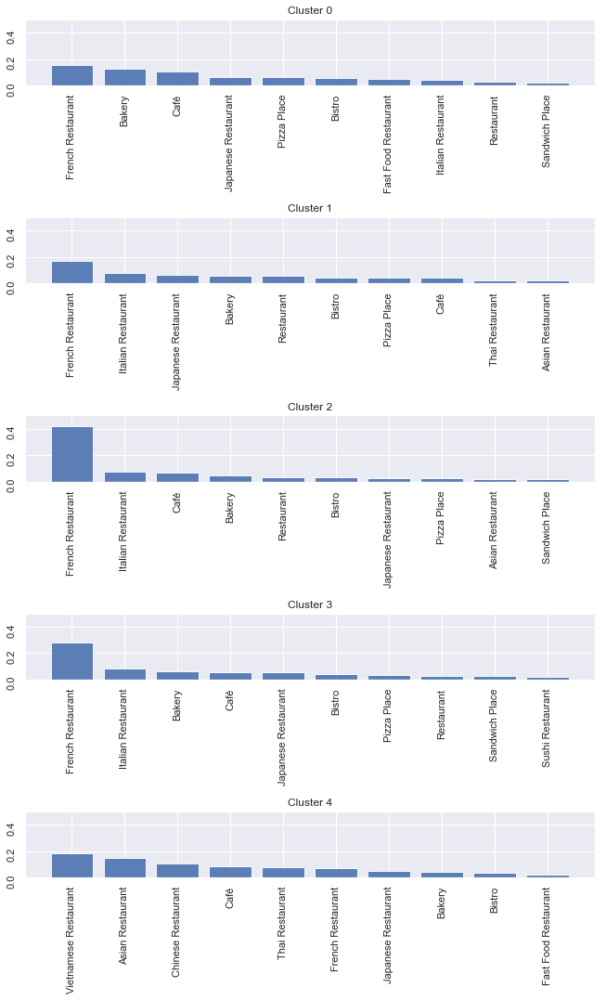

In [165]:
clusters_to_names = paris_merged[['Cluster Labels','Name']]
#paris_grouped.head()
#print(clusters_to_names.shape)
#print(clusters_to_names.head())
#paris_grouped.head()
stats = paris_grouped.join(clusters_to_names.set_index('Name'), on='Location')
stats_store = {}
x = stats.groupby('Cluster Labels').mean().T
#.sort_values('lifeExp')
for col_name in x.columns.values.tolist():
    name_cluster = "Cluster "+str(col_name)
    y = x[col_name].copy()
    ten_most = y.sort_values(ascending=False)[0:10]
    stats_store.update({name_cluster:ten_most})

    
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt


num_plots = len(stats_store.keys())

fig, ax = plt.subplots(num_plots, sharey='row') 
fig.subplots_adjust(hspace=2)
fig.set_size_inches(w=11,h=17)

for i in range(num_plots):
    name_cluster = "Cluster "+str(i)
    ploted = stats_store[name_cluster]
    ax[i].bar(ploted.index, ploted.values, alpha=0.9)
    ax[i].tick_params(rotation=90)
    ax[i].set_ylim([0, 0.5])
    ax[i].title.set_text(name_cluster)

In [167]:
paris_neighbourhood_merged = paris_merged.copy()
cl1 = paris_neighbourhood_merged.loc[paris_neighbourhood_merged['Cluster Labels'] == 0, paris_neighbourhood_merged.columns[[1] + list(range(5, paris_neighbourhood_merged.shape[1]))]]
cl2 = paris_neighbourhood_merged.loc[paris_neighbourhood_merged['Cluster Labels'] == 1, paris_neighbourhood_merged.columns[[1] + list(range(5, paris_neighbourhood_merged.shape[1]))]]
cl3 = paris_neighbourhood_merged.loc[paris_neighbourhood_merged['Cluster Labels'] == 2, paris_neighbourhood_merged.columns[[1] + list(range(5, paris_neighbourhood_merged.shape[1]))]]
cl4 = paris_neighbourhood_merged.loc[paris_neighbourhood_merged['Cluster Labels'] == 3, paris_neighbourhood_merged.columns[[1] + list(range(5, paris_neighbourhood_merged.shape[1]))]]
cl5 = paris_neighbourhood_merged.loc[paris_neighbourhood_merged['Cluster Labels'] == 4, paris_neighbourhood_merged.columns[[1] + list(range(5, paris_neighbourhood_merged.shape[1]))]]
cl5.head()

,Latitude,Density,diversity_score,proximity_score,density_score,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
30,48.830752,25782.0,1.0,0.0,1,4,Vietnamese Restaurant,French Restaurant,Chinese Restaurant,Pizza Place,Asian Restaurant,Thai Restaurant,Bakery,Sandwich Place,Cambodian Restaurant,Steakhouse
17,48.826940,25782.0,1.0,0.0,1,4,Vietnamese Restaurant,Asian Restaurant,Thai Restaurant,Chinese Restaurant,French Restaurant,Bakery,Fast Food Restaurant,Japanese Restaurant,Cambodian Restaurant,Cantonese Restaurant
8,48.823128,25782.0,1.0,0.0,1,4,Vietnamese Restaurant,Japanese Restaurant,Café,Chinese Restaurant,Restaurant,Fast Food Restaurant,Sandwich Place,Thai Restaurant,Sushi Restaurant,Bakery
264,48.880308,27674.0,0.0,0.0,1,4,Vietnamese Restaurant,Bistro,Café,Asian Restaurant,Empanada Restaurant,Fast Food Restaurant,Falafel Restaurant,Ethiopian Restaurant,English Restaurant,Egyptian Restaurant
7,48.823128,25782.0,0.0,0.0,1,4,Vietnamese Restaurant,Asian Restaurant,Chinese Restaurant,Bakery,Café,Japanese Restaurant,Thai Restaurant,Fast Food Restaurant,Cantonese Restaurant,Sandwich Place
